## Imports and Global Parameters

In [1]:
import os
import re
import pickle

import warnings
warnings.filterwarnings(action='ignore')

import numpy as np
import pandas as pd
from scipy.stats import entropy

import librosa
from audiomentations import Compose, TimeStretch, PitchShift, Shift, AddGaussianNoise
import noisereduce

import librosa.display
import IPython.display as ipd
import soundfile

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize
from PIL import Image
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf

In [2]:
# Global vars
RANDOM_SEED = 1337
SAMPLE_RATE = 32000
SIGNAL_LENGTH = 5 # seconds
SPEC_SHAPE = (48, 128) # height x width
FMIN = 500
FMAX = 12500
MAX_AUDIO_FILES = 1500

input_dir = 'basic_test/birds/'
output_dir = 'basic_test/melspectrogram_dataset/'
model_dir = 'basic_test/'
soundscape_dir = 'basic_test/'

In [3]:
import matplotlib

## Select data
Find all bird species with more than 200 entries in the training data and save that data as TRAIN and LABELS

In [4]:
# Load metadata file
train = pd.read_csv('train_metadata.csv',)

# Limit the number of training samples and classes
# First, only use high quality samples
train = train.query('rating>=4')

# Second, assume that birds with the most training samples are also the most common
# A species needs at least 200 recordings with a rating above 4 to be considered common
birds_count = {}
for bird_species, count in zip(train.primary_label.unique(), 
                               train.groupby('primary_label')['primary_label'].count().values):
    birds_count[bird_species] = count
most_represented_birds = [key for key,value in birds_count.items() if value >= 200] 

TRAIN = train.query('primary_label in @most_represented_birds')
LABELS = sorted(TRAIN.primary_label.unique())

# Let's see how many species and samples we have left
print('NUMBER OF SPECIES IN TRAIN DATA:', len(LABELS))
print('NUMBER OF SAMPLES IN TRAIN DATA:', len(TRAIN))
print('LABELS:', LABELS)

NUMBER OF SPECIES IN TRAIN DATA: 27
NUMBER OF SAMPLES IN TRAIN DATA: 8548
LABELS: ['amerob', 'barswa', 'bewwre', 'blujay', 'bncfly', 'carwre', 'compau', 'comrav', 'comyel', 'eursta', 'gbwwre1', 'grekis', 'houspa', 'houwre', 'mallar3', 'norcar', 'normoc', 'redcro', 'rewbla', 'roahaw', 'rubpep1', 'rucspa1', 'sonspa', 'spotow', 'wbwwre1', 'wesmea', 'yeofly1']


In [5]:
train.type.unique()

array(["['call']", "['call', 'song']", "['song']", ...,
       '["trisyllabic \'sueee\' calls"]',
       "['hikers', 'adult', 'call', 'male']",
       "['chimp call', 'male', 'song']"], dtype=object)

## Load single file
Load a single file and make a MEL spectogram just to visualize what the next part of the code does

SIGNAL SHAPE: (2333501,)


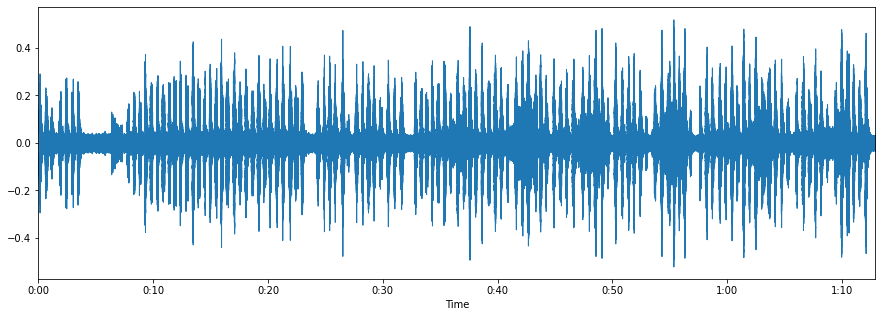

In [6]:
audio_index = 50
row = TRAIN.iloc[audio_index]
audio_path = os.path.join(input_dir, row.primary_label, row.filename)

sig, rate = librosa.load(audio_path, sr=32000, offset=None)
print('SIGNAL SHAPE:', sig.shape)

plt.figure(figsize=(15, 5))
librosa.display.waveplot(sig, sr=32000)
plt.show()

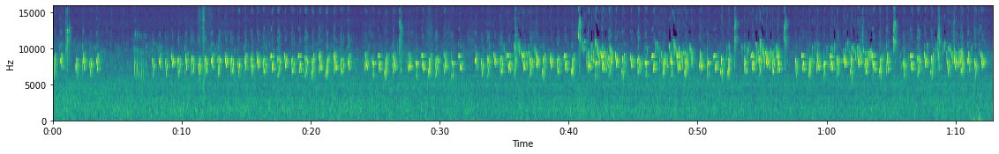

Spec shape: (48, 4558)


In [7]:
mel_spec = librosa.feature.melspectrogram(y=sig, 
                                            sr=rate, 
                                            n_fft=1024, 
                                            hop_length=512, 
                                            n_mels=SPEC_SHAPE[0], 
                                            fmin=FMIN, 
                                            fmax=FMAX)

mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

# Normalize
mel_spec -= mel_spec.min()
mel_spec /= mel_spec.max()

fig, ax = plt.subplots(figsize=(19.1,2.4))
librosa.display.specshow(mel_spec, 
                         sr=32000, 
                         x_axis='time', 
                         y_axis='hz', 
                         cmap=plt.get_cmap('viridis'))
plt.show()

print('Spec shape:',mel_spec.shape)

## Audio Data Augmentation

**Steps:**

1. Remove noise
2. More spectograms
    1. Time shift (forward and backwards)
    2. Time stretch (shorter and longer)
    3. Pitch shift (lower and higher)
3. Numerics
    1. BPM
    2. Harmonics

In [8]:
def load_audio_data(index=None, audio_file=None, verbose=True):
    if index and audio_file:
        raise ValueError('Only specify one of `index`, `audio_file`')
    elif index != None:
        row = TRAIN.iloc[index]
    elif audio_file:
        row = TRAIN[TRAIN['filename'] == audio_file].iloc[0]
    else:
        raise ValueError('Specify one of `index`, `audio_file`')
        
    audio_path = os.path.join(input_dir, row.primary_label, row.filename)

    sig, rate = librosa.load(audio_path, sr=SAMPLE_RATE, offset=None)
    
    if verbose:
        print(row.name, row.primary_label, row.filename)
    return sig, rate

# Get mel_spec
def get_mel_spec(sig):
    hop_length = int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))
    mel_spec = librosa.feature.melspectrogram(y=sig, 
                                              sr=SAMPLE_RATE, 
                                              n_fft=1024, 
                                              hop_length=hop_length, 
                                              n_mels=SPEC_SHAPE[0], 
                                              fmin=FMIN, 
                                              fmax=FMAX)

    mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

    # Normalize
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    
    return mel_spec, hop_length

def plot_mel_spec(sig, rate, **kwargs):
    mel_spec, hop_length = get_mel_spec(sig)

    return librosa.display.specshow(mel_spec, 
                                    sr=rate, 
                                    x_axis='time', 
                                    y_axis='mel', 
                                    cmap=plt.get_cmap('viridis'),
                                    hop_length=hop_length,
                                    **kwargs)


def plot_shift(sig, rate, title='', save_file=False, prefix=''):
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(20,5))
    
    librosa.display.waveplot(sig, sr=rate, ax=axes[0], color='teal')
    axes[0].set_ylabel('Amplitude (A.U.)', size=14)
    axes[0].set_xlabel(' ')
    fig.suptitle(title, size=15)
    
    plot_mel_spec(sig, rate, ax=axes[1])
    axes[1].set_ylabel('Frequency (Hz)', size=14)
    axes[1].set_xlabel('Time (s)', size=14)
    
    plt.savefig('figures/' + prefix + '.svg', pad_inches=0, bbox_inches='tight')
    
    return ipd.Audio(data=sig, rate=rate)

In [9]:
aug_elements = [
    TimeStretch(min_rate=0.95, max_rate=1.05, p=1),
    PitchShift(min_semitones=-1, max_semitones=1, p=1),
    Shift(min_fraction=-0.5, max_fraction=0.5, p=1),
]

In [10]:
sig, rate = load_audio_data(audio_file='XC174155.ogg')

1572 amerob XC174155.ogg


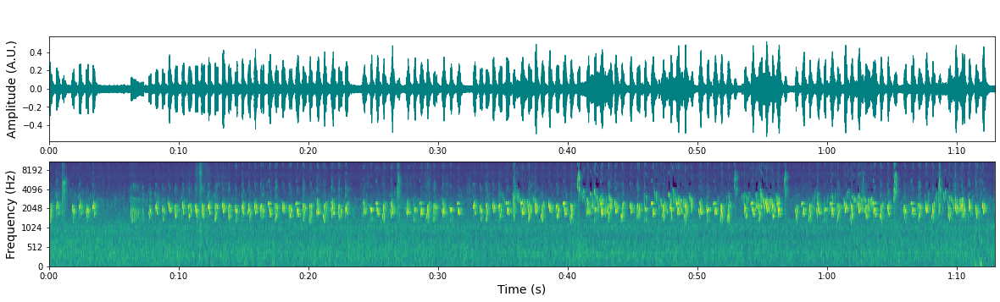

In [116]:

audio1 = plot_shift(sig, rate, title=' ', save_file=True, prefix='XC174155_Mel')

plt.show()


### Noise reduction

In [11]:
def extract_noise(sig, step=2, size=5, verbose=False):
    # Get mel spectogram
    mel_spec, _ = get_mel_spec(sig)
    
    # Column wise percentage
    mel_spec = np.nan_to_num(mel_spec/(np.sum(mel_spec, axis=0)))
    # Remove columns with only 0
    mel_spec = mel_spec.T[~np.all(mel_spec == 0, axis=0)]
    # Split into chunks
    mel_splits = [mel_spec[i : i + size] for i in range(0, len(mel_spec), step)]

    entropy_splits = []
    
    for split in mel_splits:
        entropy_scores = [entropy(x) for x in split]
        entropy_splits.append((min(entropy_scores), np.mean(entropy_scores)))

    l = [sum(x) for x in entropy_splits] 
    
    try:
        l = l.index(max(l))
    except ValueError:
        return None
    
    if verbose==True:
        print('N splits:', len(mel_splits))
        print('Best split:', l)
    
    a = size/mel_spec.shape[0]
    b = step*l/mel_spec.shape[0]
    c = round(sig.shape[0]*b)
    d = round(sig.shape[0]*a)
    #breakpoint()
    noise = sig[c:c+d]
    
    return noise

def reduce_noise(sig, use_tensorflow=True, **kwargs):
    '''
    **kwargs : {
        step=2, size=5, verbose=False
    }
    '''
    noise = extract_noise(sig, **kwargs)
    return noisereduce.reduce_noise(sig, noise, use_tensorflow=use_tensorflow, verbose=False)

def get_chroma(sig, rate):
    norm = np.inf
    n_fft = 2048
    win_length = None
    return librosa.feature.chroma_stft(y=sig, sr=rate, norm=norm, n_fft=n_fft, win_length=win_length)

def clean_chroma(sig, rate, method=np.mean, threshold=0.9):
    chroma = get_chroma(sig, rate)
    return chroma.T[np.where(method(chroma, axis=0) < threshold)].T

N splits: 927
Best split: 721
Original audio:


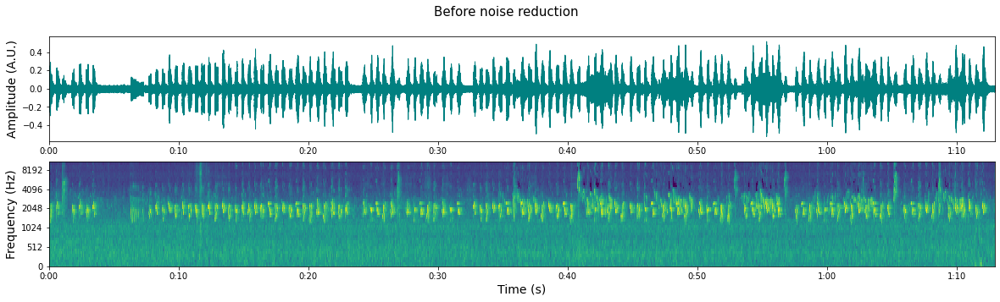


Noise reduced:


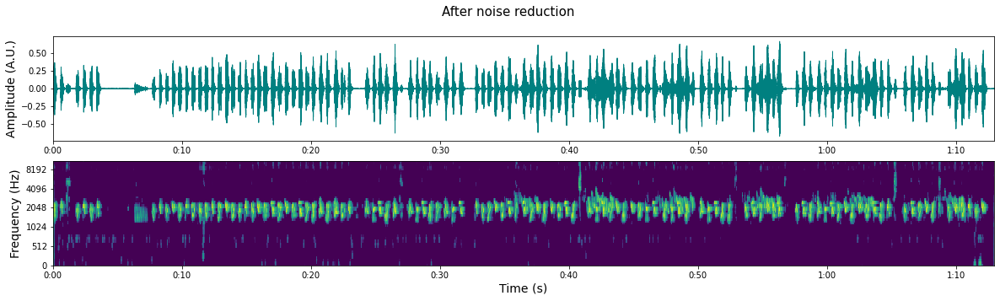

In [113]:
reduced_noise = reduce_noise(sig, step=2, size=5, verbose=True)

print('Original audio:')
audio1 = plot_shift(sig, rate, title='Before noise reduction', save_file=True, prefix='XC174155')
ipd.display(audio1)
plt.show()
print()
audio3 = plot_shift(reduced_noise, rate, title='After noise reduction', save_file=True, prefix='XC174155_noise_reduced')
print('Noise reduced:')
ipd.display(audio3)

soundfile.write('sounds/XC174155_noise_reduced.wav', reduced_noise, rate, 'PCM_24')

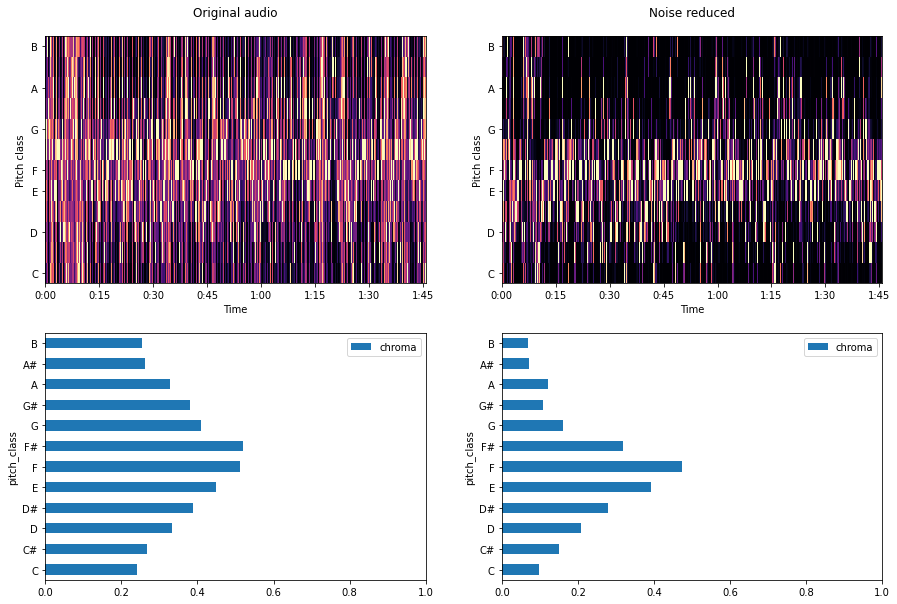

In [13]:
chroma1 = clean_chroma(sig, rate)
chroma2 = clean_chroma(reduced_noise, rate)

fig, axes = plt.subplots(nrows=2,ncols=2,figsize = (15, 10))

img = librosa.display.specshow(chroma1, y_axis='chroma', x_axis='time', ax=axes[0][0])
axes[0][0].set_title('Original audio', pad=20)

img = librosa.display.specshow(chroma2, y_axis='chroma', x_axis='time', ax=axes[0][1])
axes[0][1].set_title('Noise reduced', pad=20)

chromasum1 = pd.DataFrame({'chroma' : chroma1.mean(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum1.plot(kind='barh', y='chroma', x='pitch_class', ax=axes[1][0])
axes[1][0].set_xlim(0,1)

chromasum2 = pd.DataFrame({'chroma' : chroma2.mean(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum2.plot(kind='barh', y='chroma', x='pitch_class', ax=axes[1][1])
axes[1][1].set_xlim(0,1)

plt.show()

### Audio modifications

#### ~Add noise~

**Pink noise**

In [14]:
import colorednoise as cn
beta = 2 # the exponent
samples = len(sig) # number of samples to generate
y = cn.powerlaw_psd_gaussian(beta, samples)

ModuleNotFoundError: No module named 'colorednoise'

In [ ]:
sig_pink_noise = sig + y

In [ ]:
plot_shift(sig_pink_noise, rate)

**Random noise**

In [ ]:
sig_random_noise = sig + 0.009*np.random.normal(0,1,len(sig))

In [ ]:
plot_shift(sig_random_noise, rate)

**Gaussian noise**

In [ ]:
sig_gauss_noise = Compose([AddGaussianNoise(min_amplitude=0.01, max_amplitude=0.015, p=1)])(sig, rate)

In [ ]:
plot_shift(sig_gauss_noise, rate)

#### Time shift

In [37]:
def time_shift(sig, rate, roll=0.1):
    return np.roll(sig, int(rate/roll))

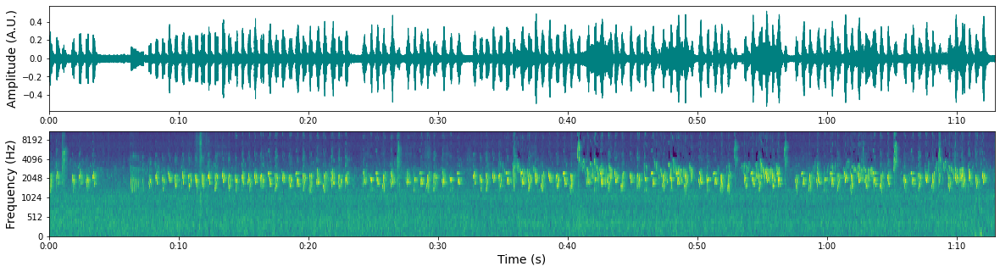

In [38]:
plot_shift(sig, rate)

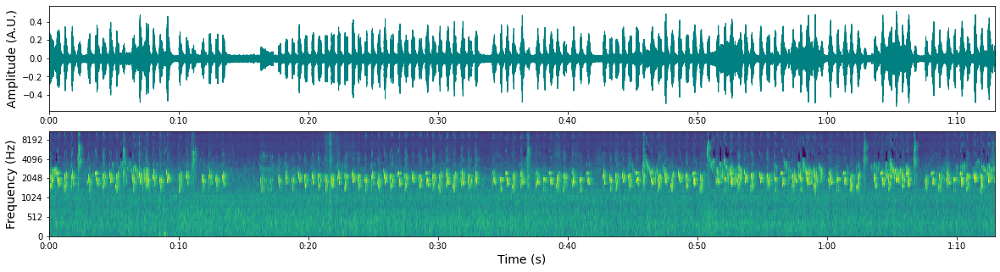

In [39]:
wav_roll = time_shift(sig, rate, roll = 0.1)
plot_shift(wav_roll, rate)

#### Time stretch

In [40]:
def time_stretch(sig, factor):
    return librosa.effects.time_stretch(sig,factor)

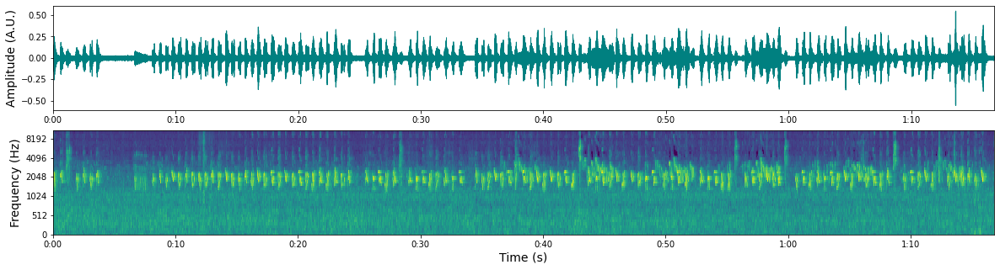

In [41]:
factor = 0.95
wav_time_stch = time_stretch(sig, factor)
plot_shift(wav_time_stch, rate)

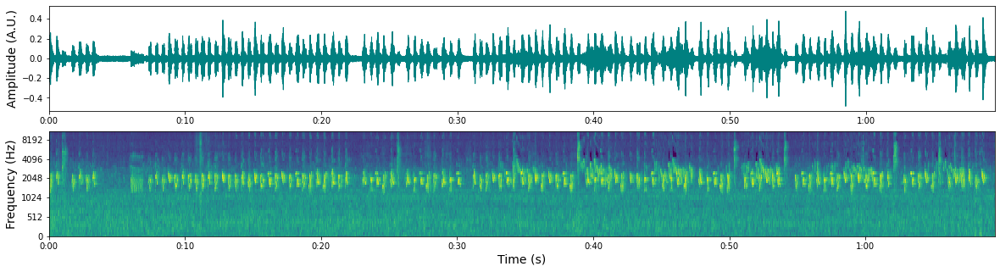

In [42]:
factor = 1.05
wav_time_stch = librosa.effects.time_stretch(sig,factor)
plot_shift(wav_time_stch, rate)

#### Pitch shift

In [43]:
def pitch_shift(sig, rate, n_steps):
    return librosa.effects.pitch_shift(sig, rate, n_steps=n_steps)

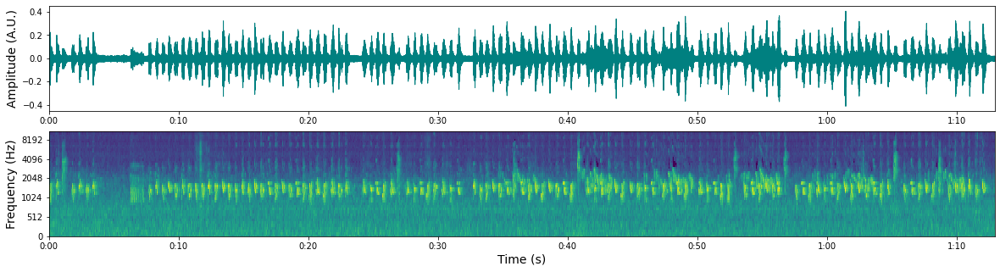

In [44]:
wav_pitch_sf = pitch_shift(sig, rate, -5)
plot_shift(wav_pitch_sf, rate)

#### Presentation

In [45]:
# Split signal into five second chunks
sig_splits = []
for i in range(0, len(reduced_noise), int(SIGNAL_LENGTH * SAMPLE_RATE)):
    split = reduced_noise[i:i + int(SIGNAL_LENGTH * SAMPLE_RATE)]

    # End of signal?
    if len(split) < int(SIGNAL_LENGTH * SAMPLE_RATE):
        break

    sig_splits.append(split)

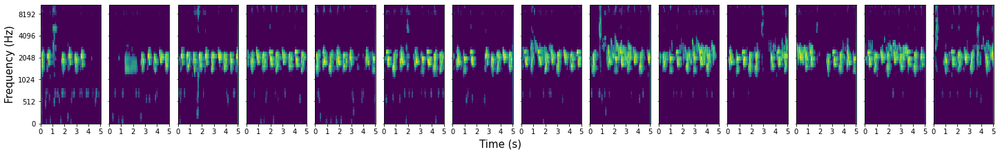

In [75]:
fig, axes = plt.subplots(nrows=1, ncols=len(sig_splits), figsize=(20,3), constrained_layout=True)

axes = axes.flatten()

for n, split in enumerate(sig_splits):
    # Plot mel_spec
    plot_mel_spec(split, rate=rate, ax=axes[n])
    axes[n].set_xticks([x for x in range(6)])
    axes[n].set_xlabel('')
    if n==0:
        axes[n].set_ylabel('Frequency (Hz)', fontsize=15)
    else:
        axes[n].set_ylabel('')
        axes[n].set_yticks([])
        
fig.supxlabel('Time (s)', fontsize=15)
plt.savefig('figures/aftersplit.svg', pad_inches=0, bbox_inches='tight')
plt.show()

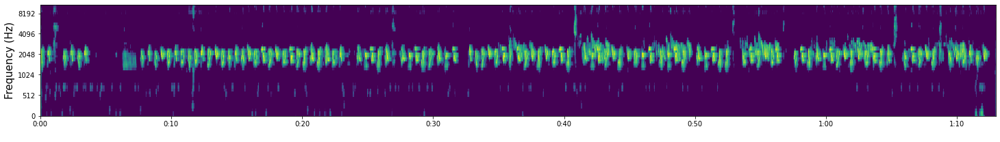

In [79]:
fig, ax = plt.subplots(figsize=(25,3))
plot_mel_spec(reduced_noise, rate=rate)
ax.set_ylabel('Frequency (Hz)', fontsize=15)
ax.set_xlabel(' ',)
plt.savefig('figures/beforesplit.svg', pad_inches=0, bbox_inches='tight')
plt.show()

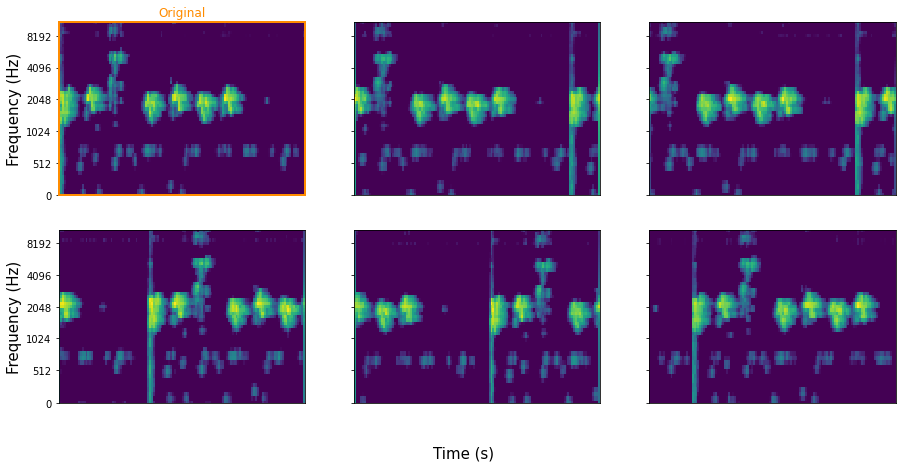

In [82]:
sig_to_aug = sig_splits[0]

# Construct augment object
augment = Compose(aug_elements)
n_augments = 5

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15,7), sharey=True)

# Display audio
audio = ipd.Audio(data=sig_to_aug, rate=rate)
ipd.display(audio)

axes = axes.flatten()

# Plot mel_spec
plot_mel_spec(sig_to_aug, rate, ax=axes[0])
axes[0].set_xticks([])
axes[0].set_xlabel('')
axes[0].set_title('Original', color='darkorange')
for spine in axes[0].spines.values():
    spine.set_edgecolor('darkorange')
    spine.set_linewidth(2)
    
# Do the same n times for augmented signals
for k in range(n_augments):
    k += 1
    sig_aug = augment(sig_to_aug, rate)
    plot_mel_spec(sig_aug, rate, ax=axes[k])
    axes[k].set_xticks([])
    axes[k].set_xlabel('')
    if k%3:
        axes[k].set_ylabel('')
    ipd.display(audio)
    
fig.supxlabel('Time (s)', fontsize=15)
axes[0].set_ylabel('Frequency (Hz)', fontsize=15)
axes[3].set_ylabel('Frequency (Hz)', fontsize=15)

plt.savefig('figures/audio_augmentation_real.svg')
plt.show()

In [54]:
aug_elements = [
    TimeStretch(min_rate=0.95, max_rate=1.05, p=1),
    PitchShift(min_semitones=-1, max_semitones=1, p=1),
    Shift(min_fraction=-0.5, max_fraction=0.5, p=1),
]

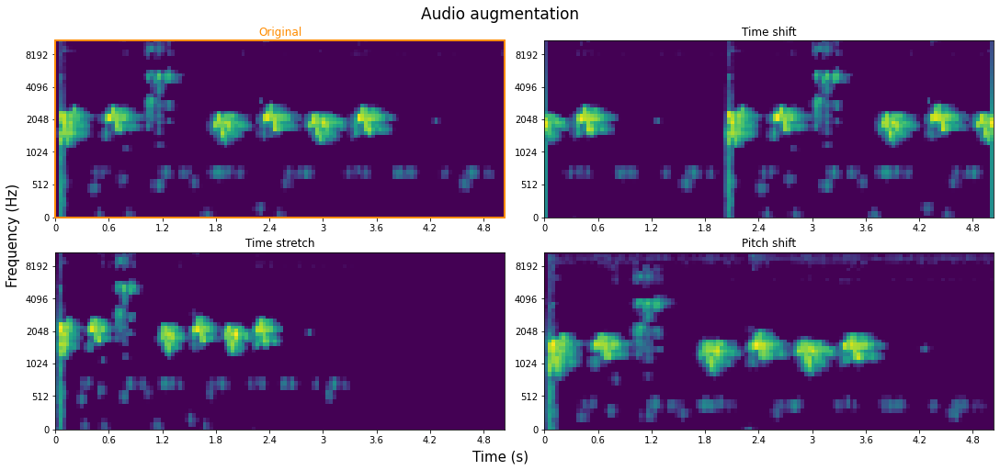

In [83]:
sig_to_aug = sig_splits[0]

# Display audio
audio = ipd.Audio(data=sig_to_aug, rate=rate)
ipd.display(audio)

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,7), constrained_layout=True)

fig.suptitle('Audio augmentation', fontsize=17)
axes = axes.flatten()

# Plot mel_spec
plot_mel_spec(sig_to_aug, rate, ax=axes[0])
axes[0].set_title('Original', color='darkorange')
axes[0].set_xlabel('')
axes[0].set_ylabel('')
for spine in axes[0].spines.values():
    spine.set_edgecolor('darkorange')
    spine.set_linewidth(2)

time_shifted = time_shift(sig_to_aug, rate, roll=0.5)
plot_mel_spec(time_shifted, rate, ax=axes[1])
axes[1].set_title('Time shift')
axes[1].set_xlabel('')
axes[1].set_ylabel('')

time_stretched = Compose([TimeStretch(min_rate=1.5, max_rate=1.5, p=1)])(sig_to_aug, rate) #time_stretch(sig_to_aug, factor=1.5)
plot_mel_spec(time_stretched, rate, ax=axes[2])
axes[2].set_title('Time stretch')
axes[2].set_xlabel('')
axes[2].set_ylabel('')

pitch_shifted = pitch_shift(sig_to_aug, rate, n_steps=-5)
plot_mel_spec(pitch_shifted, rate, ax=axes[3])
axes[3].set_title('Pitch shift')
axes[3].set_xlabel('')
axes[3].set_ylabel('')

# # Do the same n times for augmented signals
# for k in range(n_augments):
#     k += 1
#     sig_aug = augment(sig_to_aug, rate)
#     plot_mel_spec(sig_aug, rate, ax=axes[k])
#     axes[k].set_xticks([])
#     axes[k].set_xlabel('')
#     if k%3:
#         axes[k].set_ylabel('')
#     ipd.display(audio)
    
fig.supxlabel('Time (s)', fontsize=15)
fig.supylabel('Frequency (Hz)', fontsize=15, rotation=90)

plt.savefig('figures/audio_augmentation.svg')
plt.show()

### Extracting other audio dimensions

#### BPM

In [15]:
def bpm(sig, rate):
    return librosa.beat.beat_track(y=sig, sr=rate)

In [16]:
tempo, beat_frames = bpm(sig, rate)
tempo

117.1875

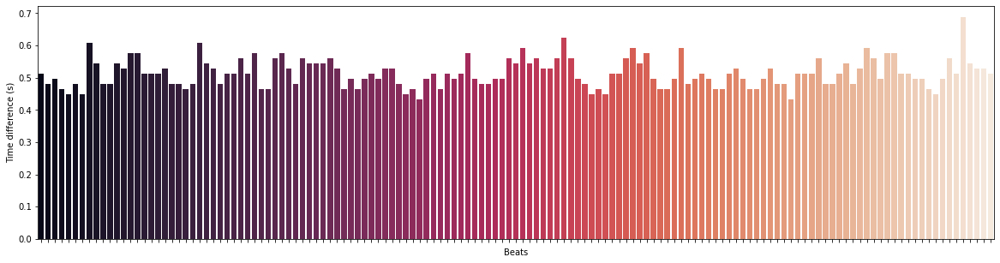

In [17]:
beat_times = librosa.frames_to_time(beat_frames, sr=rate)
beat_time_diff = np.ediff1d(beat_times)
beat_nums = np.arange(1, np.size(beat_times))
fig, ax = plt.subplots()
fig.set_size_inches(20, 5)
ax.set_ylabel("Time difference (s)")
ax.set_xlabel("Beats")
g = sns.barplot(beat_nums, beat_time_diff, palette="rocket",ax=ax)
g = g.set(xticklabels=[])

In [18]:
extra_path = 'D:/birdclef-2021/'

In [19]:
with open(extra_path + 'numeric_data.pickle', 'rb') as f:
    num = pickle.load(f)

In [20]:
errors = [x for y in num for x in y if type(x)==str]
num = [x for y in num for x in y if type(x)==dict]
num = {k:v for elem in num for (k,v) in elem.items()}
num = {k.split('/')[-1]:v for k,v in num.items()}

In [21]:
num_df = pd.DataFrame(num.values())

num_df['specie'] = num.keys()

num_df = num_df[~num_df['specie'].str.contains('aug')].reset_index(drop=True)

num_df['specie'] = num_df['specie'].apply(lambda x: x[:-7])

num_df['specie'] = num_df['specie'].apply(lambda x: x.split('\\')[0])

In [22]:
num_df

,bpm,C,C#,D,D#,E,F,F#,G,G#,A,A#,B,specie
0,120.967742,0.135321,0.077294,0.047169,0.087716,0.107651,0.217298,0.660030,0.439673,0.147885,0.161494,0.136439,0.218832,normoc
1,120.967742,0.109928,0.081227,0.068847,0.057780,0.115981,0.144913,0.513657,0.700517,0.307376,0.187217,0.166450,0.112936,normoc
2,120.967742,0.069372,0.030659,0.041744,0.053831,0.117954,0.117857,0.562452,0.673870,0.260655,0.139885,0.136989,0.111478,normoc
3,120.967742,0.098663,0.122729,0.243311,0.121322,0.179222,0.353865,0.285486,0.214311,0.226677,0.242180,0.144889,0.125354,rubpep1
4,120.967742,0.094014,0.126403,0.117492,0.114600,0.287587,0.461441,0.252578,0.191605,0.211908,0.289075,0.202826,0.121429,rubpep1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23656,120.967742,0.184352,0.422844,0.770045,0.130818,0.085335,0.134205,0.207589,0.145395,0.122018,0.114230,0.099918,0.112487,yeofly1
23657,0.000000,0.470610,0.460134,0.448259,0.258608,0.270370,0.373848,0.564378,0.365522,0.273255,0.243866,0.246069,0.311244,yeofly1
23658,19.841270,0.246823,0.191105,0.208815,0.320328,0.372278,0.409241,0.420839,0.210555,0.223365,0.288354,0.213003,0.204066,gbwwre1
23659,0.000000,0.132090,0.232928,0.162176,0.192881,0.183810,0.165946,0.228391,0.106747,0.130848,0.257981,0.351269,0.248420,gbwwre1


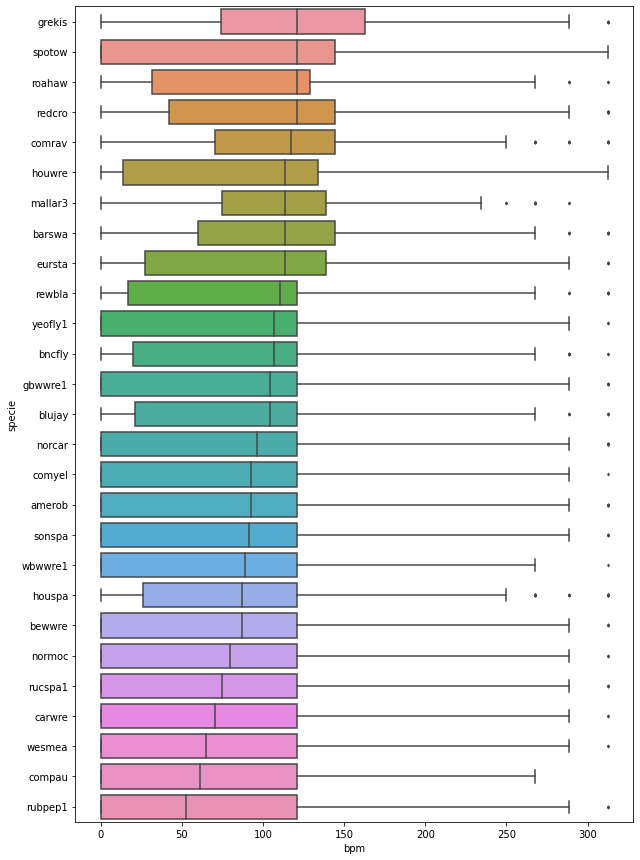

In [110]:
#data = TRAIN[~TRAIN['tempo'].isna()]
order = num_df.groupby('specie')['bpm'].median().sort_values(ascending=False).index
fig, ax = plt.subplots(figsize=(10,15))
sns.boxplot(x=num_df['bpm'], y=num_df['specie'], order=order, fliersize=2, orient='h', ax=ax,)
#sns.swarmplot(x=num_df['bpm'], y=num_df['specie'], order=order, color=".25", ax=ax)
plt.show()

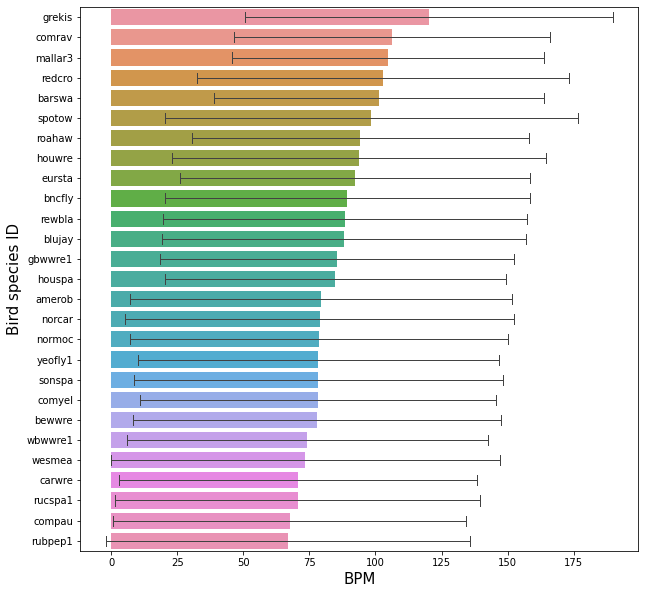

In [111]:
order = num_df.groupby('specie')['bpm'].mean().sort_values(ascending=False).index
fig, ax = plt.subplots(figsize=(10,10))
sns.barplot(x=num_df['bpm'], y=num_df['specie'], order=order, ci='sd', errwidth=1, capsize=0.5, orient='h', ax=ax,)

ax.set_ylabel('Bird species ID', size=15)
ax.set_xlabel('BPM', size=15)



plt.savefig('figures/bpm.svg', pad_inches=0, bbox_inches='tight')
plt.show()

#### Harmonics

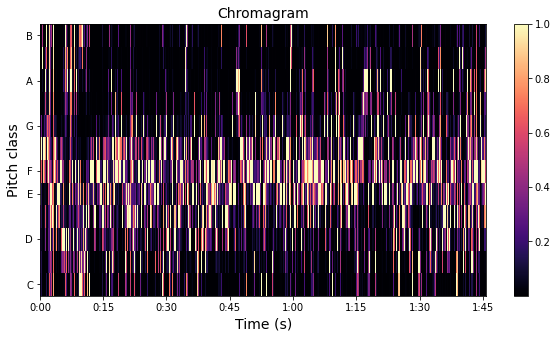

In [107]:
chroma=librosa.feature.chroma_stft(y=reduced_noise, sr=rate)
fig, ax = plt.subplots(1,figsize = (10, 5))
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax)
fig.colorbar(img, ax=ax)
ax.set_title('Chromagram', fontsize=14)

ax.set_ylabel('Pitch class', size=14)
ax.set_xlabel('Time (s)', size=14)
plt.savefig('figures/chromagram.svg')

<AxesSubplot:ylabel='pitch_class'>

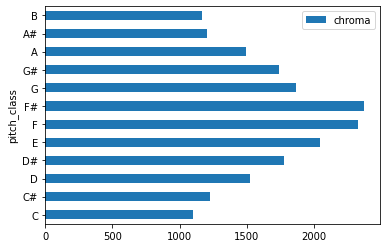

In [26]:
chromasum = pd.DataFrame({'chroma' : chroma.sum(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum.plot(kind='barh', y='chroma', x='pitch_class')

In [27]:
# df = pd.DataFrame()

# for idx in tqdm(range(len(TRAIN)), smoothing=0):
#     try:
#         sig, rate = load_audio_data(idx, verbose=False)
#         chroma = librosa.feature.chroma_stft(y=sig, sr=rate)
#         chromasum = pd.DataFrame(chroma.mean(axis=1)).T
#         chromasum['specie'] = TRAIN.iloc[idx]['primary_label']
#         df = pd.concat([df, chromasum])
#     except FileNotFoundError:
#         pass
    
# df.columns = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B','specie']
# df = df.reset_index(drop=True)

In [28]:
# data = num.melt(id_vars='specie')

In [29]:
data = num_df[num_df.columns[1:]].melt(id_vars='specie')

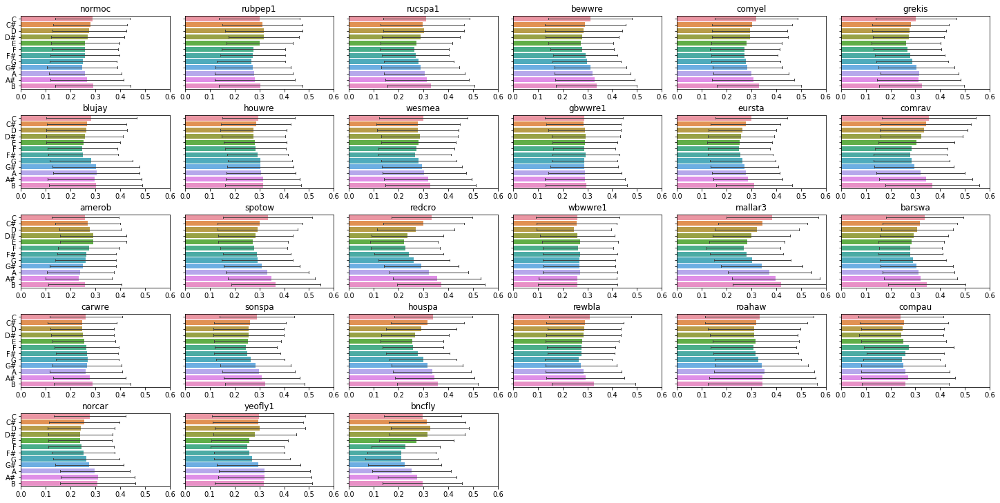

In [108]:
n_cols = 6
n_rows = 5
species = data['specie'].unique()
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20,10), constrained_layout=True, sharey=True)

for specie, ax in zip(species, axes.flatten()):
    row = data[data['specie'] == specie]
    sns.barplot(x=row['value'], y=row['variable'], ci='sd', errwidth=1, capsize=0.3, orient='h', ax = ax)
    ax.set(title=specie)
    ax.set(xlim=(0,0.6))
    ax.set_xlabel('')
    ax.set_ylabel('')
    
for ax in axes.flatten()[len(species):]:
    ax.axis('off')

plt.savefig('figures/pitches.svg')
plt.show()

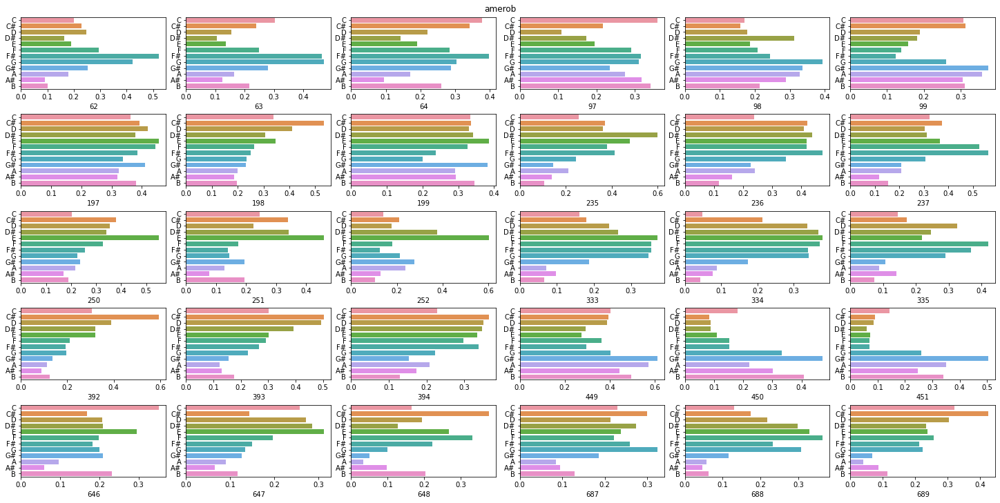

In [109]:
n_cols = 6
n_rows = 5
specie = 'amerob'

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20,10), constrained_layout=True)

fig.suptitle(specie)

for ax, (index, row) in zip(axes.flatten(), num_df[num_df['specie'] == specie][:50].iterrows()):
    row = row[1:-1]
    sns.barplot(x=row, y=row.index, ax=ax, orient='h')
    
plt.savefig('figures/pitches_amerob.svg')

## Define load function
Load a specified portion of the the selected training data (MAX_AUDIO_FILES) and have librosa generate MEL spectograms of it in sections of a specifieed number of seconds (SIGNAL_LENGTH)

In [32]:
# Define a function that splits an audio file, 
# extracts spectrograms and saves them in a working directory
def get_spectrograms(filepath, primary_label, output_dir, noise='reduced'):
    
    # Open the file with librosa (limited to the first 15 seconds)
    sig, rate = librosa.load(filepath, sr=SAMPLE_RATE, offset=None, duration=15)

    # Reduce noise
    if noise == 'reduced':
        sig = reduce_noise(sig, verbose=False)
    elif noise =='gaussian':
        elements.append(AddGaussianNoise(min_amplitude=0.01, max_amplitude=0.015, p=1))
    else:
        raise ValueError('noise must be either `reduce` or `gaussian`')
    
    augment = Compose(aug_elements)
    
    # Split signal into five second chunks
    sig_splits = []
    for i in range(0, len(sig), int(SIGNAL_LENGTH * SAMPLE_RATE)):
        split = sig[i:i + int(SIGNAL_LENGTH * SAMPLE_RATE)]

        # End of signal?
        if len(split) < int(SIGNAL_LENGTH * SAMPLE_RATE):
            break
        
        sig_splits.append(split)
        
    # Extract mel spectrograms for each audio chunk
    s_cnt = 0
    saved_samples = []
    for chunk in sig_splits:
        
        results = [(chunk, '')]
        
        for n in range(5):
            results.append((augment(chunk, rate), f'aug{n}'))
        
        for result, image_name in results:
            mel_spec = get_mel_spec(result)
           
            # Save as image file
            save_dir = os.path.join(output_dir, primary_label)
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            save_path = os.path.join(save_dir, 
                                     filepath.rsplit(os.sep, 1)[-1].rsplit('.', 1)[0] + '_' + str(s_cnt) + '_' + image_name + '.png')
            
            im = Image.fromarray(mel_spec * 255.0).convert("L")
            im.save(save_path)
            
            chroma = clean_chroma(chunk, rate)
            chromasum = {k:v for k, v in zip(['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B'], chroma.mean(axis=1))}
            
            tempo, _ = bpm(chunk, rate)
            
            numeric_data = {
                'bpm' : tempo,
                **chromasum
            }
            
            saved_samples.append({save_path:numeric_data})
        s_cnt += 1
        
    return saved_samples

## Load spectograms
Run the load function

In [33]:
import joblib

In [34]:
input_dir = 'D:/birdclef-2021/train_short_audio'

In [35]:
output_dir = 'basic_test/melspectrogram_dataset_gauss_noise/'

# Parse audio files and extract training samples
specto_paths = []
for idx, row in tqdm(TRAIN.iterrows(), total=len(TRAIN), smoothing=0.01):
    if row.primary_label in most_represented_birds:
        audio_file_path = os.path.join(input_dir, row.primary_label, row.filename)
        specto_paths.append((audio_file_path, row.primary_label, output_dir))

jobs = [joblib.delayed(get_spectrograms)(i, c, o) for i,c,o in specto_paths]

  0%|          | 0/8548 [00:00<?, ?it/s]

In [36]:
out = joblib.Parallel(n_jobs=6, verbose=100)(jobs)

[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   1 tasks      | elapsed:   24.2s
[Parallel(n_jobs=6)]: Done   2 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   3 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   4 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   5 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   6 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   7 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   8 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done   9 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done  10 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done  11 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done  12 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done  13 tasks      | elapsed:   24.3s
[Parallel(n_jobs=6)]: Done  14 tasks      | elapsed:   24.3s


KeyboardInterrupt: 

In [ ]:
samples= [x for y in out for x in y]
TRAIN_SPECS = shuffle(samples, random_state=RANDOM_SEED)
print('SUCCESSFULLY EXTRACTED {} SPECTROGRAMS'.format(len(TRAIN_SPECS)))

## Plot spectograms

In [ ]:
# Plot the first 12 spectrograms of TRAIN_SPECS
plt.figure(figsize=(15, 7))
for i in range(12):
    file = list(TRAIN_SPECS[i].keys())[0]
    spec = Image.open(file)
    plt.subplot(3, 4, i + 1)
    plt.title(file.split(os.sep)[-1])
    plt.imshow(spec, origin='lower')

## Load data
Load spectograms and normalize, and add to a stack of 4154 sound bites, of 48 (MEL resolution) x 128 (time resolution) pixels. Labels are 4154 one-hot vectors of length 27 (number of bird types)

In [ ]:
output_dir = 'basic_test/melspectrogram_dataset_gauss_noise/'

In [ ]:
output_dir = 'basic_test/melspectrogram_dataset/'

### Save specto-arrays

In [ ]:
output_dir = 'D:/melspectrogram_dataset_gauss_noise/'

In [ ]:
img_height, img_width = 48, 128

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    output_dir,
    label_mode="categorical",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=32,
    color_mode="grayscale",
    shuffle=False)

image_files = train_ds.file_paths

In [ ]:
normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
train_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
x, y = [], []
for data in tqdm(train_ds.as_numpy_iterator(), total = len(train_ds)):
    x.append(data[0])
    y.append(data[1])
    
x = np.asarray([a for b in x for a in b])
y = np.asarray([a for b in y for a in b])

assert len(x) == len(y) == len(image_files)

In [ ]:
x = {file:img for file, img in zip(image_files, x)}
y = {file:img for file, img in zip(image_files, y)}

In [ ]:
extra_path = 'D:/birdclef-2021/'

In [ ]:
response = input('Are you sure you want to write x and y files? y/n:\n')

if response.lower() == 'y':
    with open(extra_path + 'img_reduced_noise_x.pickle', 'wb') as f:
        pickle.dump(x, f)

    with open(extra_path + 'img_reduced_noise_y.pickle', 'wb') as f:
        pickle.dump(y, f)

### Load specto-arrays

In [ ]:
with open(extra_path + 'img_reduced_noise_x.pickle', 'rb') as f:
    x = pickle.load(f)
    
with open(extra_path + 'img_reduced_noise_y.pickle', 'rb') as f:
    y = pickle.load(f)

In [ ]:
# img_array = [(a,b) for a, b in zip(x,y)]

# img_dataset = tf.data.Dataset.from_tensor_slices((x, y))
# img_dataset

### Load numeric data

In [ ]:
with open(extra_path + 'numeric_data.pickle', 'rb') as f:
    num = pickle.load(f)

In [ ]:
errors = [x for y in num for x in y if type(x)==str]
num = [x for y in num for x in y if type(x)==dict]
num = {k:v for elem in num for (k,v) in elem.items()}
num = {k.split('/')[-1]:v for k,v in num.items()}

In [ ]:
num_df = pd.DataFrame(num.values())

num_df['specie'] = num.keys()

num_df = num_df[~num_df['specie'].str.contains('aug')].reset_index(drop=True)

num_df['specie'] = num_df['specie'].apply(lambda x: x[:-7])

num_df['specie'] = num_df['specie'].apply(lambda x: x.split('\\')[0])

In [ ]:
x = {k.split('/')[-1]:v for k,v in x.items()}
y = {k.split('/')[-1]:v for k,v in y.items()}

In [ ]:
num_files = list(num.keys())
x_files = list(x.keys())

In [ ]:
intersection = np.intersect1d(x_files, num_files)

In [ ]:
x_cleaned = {key: x[key] for key in intersection}
y_cleaned = {key: y[key] for key in intersection}
num_cleaned = {key: num[key] for key in intersection}

### Create arrays

In [ ]:
# Image data
x = np.array(list(x_cleaned.values()))
y = np.array(list(y_cleaned.values()))

In [ ]:
# Add latitude and longitude information to numeric data
for data in tqdm(num_cleaned, smoothing=0.01):
    lat, lon = TRAIN[TRAIN['filename'] == data.split('\\')[-1].split('_')[0] + '.ogg'][['latitude', 'longitude']].values[0]
    num_cleaned[data]['lat'] = lat
    num_cleaned[data]['lon'] = lon

In [ ]:
# Numeric data
num_data = []
num_labels = []

for data in tqdm(num_cleaned):
    num_data.append(list(num_cleaned[data].values()))
    num_labels.append(data.split('/')[-1].split('\\')[0])

# Normalize data and create arrays
num_data = normalize(np.array(num_data), norm='max', axis=0)
num_labels = np.array([[float(label == x) for x in LABELS] for label in num_labels])

In [ ]:
num_dataset = tf.data.Dataset.from_tensor_slices((num_data, train_labels))
num_dataset

In [ ]:
# Check length
assert len(num_data) == len(num_labels) == len(x) == len(y)

# Check order of labels/observations
assert (num_labels == y).all()

In [ ]:
extra_path

In [ ]:
with open(extra_path + 'final_x.pickle', 'wb') as f:
    pickle.dump(x, f)

with open(extra_path + 'final_y.pickle', 'wb') as f:
    pickle.dump(y, f)

with open(extra_path + 'final_num_x.pickle', 'wb') as f:
    pickle.dump(num_data, f)

with open(extra_path + 'final_num_y.pickle', 'wb') as f:
    pickle.dump(num_labels, f)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=RANDOM_SEED)

In [ ]:
num_x_train, num_x_test, num_y_train, num_y_test = train_test_split(num_data, num_labels, test_size=0.1, random_state=RANDOM_SEED)

In [ ]:
assert (num_y_train == y_train).all()

## Building model
Input layers dimensions are 48x128 (spec resolution) and output length is 27

Two different ways of implementing mixed inputs
Add to the dense layers of a convoluted network  
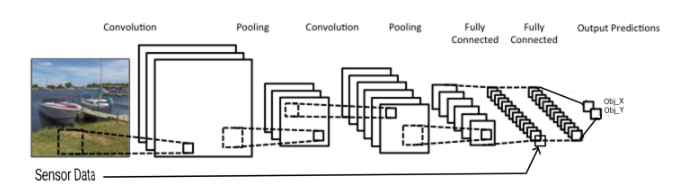

Create two different models and concatenate them (https://www.pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/)  
<img src="https://pyimagesearch.com/wp-content/uploads/2019/02/keras_multi_input_design.png" alt="drawing" width="400"/>




In [ ]:
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, Activation, Dropout, Dense, Flatten, Input, RepeatVector, GlobalAveragePooling2D, GlobalAveragePooling3D, Concatenate, LSTM, ConvLSTM2D, TimeDistributed, Reshape
from tensorflow.keras.models import Model, Sequential

def create_callbacks(model_name):
    # Add callbacks to reduce the learning rate if needed, early stopping, and checkpoint saving
    callbacks = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', 
                                                      patience=2, 
                                                      verbose=1, 
                                                      factor=0.5),
                 tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                  verbose=1,
                                                  patience=10),
                 tf.keras.callbacks.CSVLogger(filename=model_dir + f'{model_name}_log.csv', 
                                              separator=',', 
                                              append=False),
                 tf.keras.callbacks.ModelCheckpoint(filepath=model_dir + f'best_model_{model_name}.h5', 
                                                    monitor='val_loss',
                                                    verbose=0,
                                                    save_best_only=True)]
    
    return callbacks

### CNN

In [ ]:
def create_cnn(output=False):
    cnn_inputs = Input(shape=(SPEC_SHAPE[0], SPEC_SHAPE[1], 1))

    cnn = cnn_inputs

    # Define number of neurons and filter size for the convoluted blocks
    blocks = (
        (16, (3,3)),
        (32, (3,3)),
        (64, (3,3)),
        (128, (3,3)),
    )

    # Create the convoluted blocks
    for block in blocks:
        # Convoluted layer
        cnn = Conv2D(block[0], block[1])(cnn)
        # Batch normalization
        cnn = BatchNormalization()(cnn)
        # Max pooling
        cnn = MaxPooling2D((2, 2))(cnn)
    
    # Global pooling
    cnn = GlobalAveragePooling2D()(cnn)
        
    # LSTM
    #cnn = TimeDistributed(cnn)(cnn_inputs)
    #cnn = LSTM(64)(cnn)

    # Dense block
    cnn = Dense(256, activation='relu')(cnn)
    cnn = Dropout(0.5)(cnn)
    # Dense block
    cnn = Dense(256, activation='relu')(cnn)
    cnn = Dropout(0.5)(cnn)

    if output==True:
        # Classification layer
        cnn = Dense(len(LABELS), activation='softmax')(cnn)

    cnn = Model(cnn_inputs, cnn)
    
    return cnn

cnn = create_cnn(output=True)

cnn.summary()

In [ ]:
cnn.compile(optimizer=tf.keras.optimizers.Adam(lr=0.01),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

cnn_callbacks = create_callbacks('cnn')

cnn.fit(x=x,
        y=y,
        validation_split=0.2,
        batch_size=32,
        callbacks=cnn_callbacks,
        epochs=100)

### MLP

In [ ]:
def create_mlp(output=False):
    mlp_inputs = Input(shape=(num_data.shape[1]))

    mlp = mlp_inputs

    mlp = Dense(15, activation="relu")(mlp)
    mlp = Dense(15, activation="relu")(mlp)
    mlp = Dropout(0.1)(mlp)
    
    # Classification layer
    if output==True:
         mlp = Dense(len(LABELS), activation='softmax')(mlp)

    mlp = Model(mlp_inputs, mlp)
    
    return mlp

mlp = create_mlp(output=True)

mlp.summary()

In [ ]:
mlp.compile(optimizer=tf.keras.optimizers.Adam(lr=0.01),
            loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
            metrics=['accuracy'])

mlp_callbacks = create_callbacks('mlp')

mlp.fit(num_x_train,
        num_y_train,
        batch_size=32,
        validation_split=0.2,
        callbacks=mlp_callbacks,
        epochs=100)

### LSTM

In [ ]:
def create_lstm(output=False):
    lstm_inputs = Input(shape=(SPEC_SHAPE[0], SPEC_SHAPE[1]))

    lstm = lstm_inputs

    lstm = LSTM(80, activation="tanh", return_sequences=True)(lstm)
    lstm = LSTM(64, activation="tanh", return_sequences=True)(lstm)
    lstm = LSTM(48, activation="tanh", return_sequences=True)(lstm)
    lstm = LSTM(32, activation="tanh")(lstm)
    
    # Classification layer
    if output==True:
         lstm = Dense(len(LABELS), activation='softmax')(lstm)

    lstm = Model(lstm_inputs, lstm)
    
    return lstm

lstm = create_lstm(output=True)

lstm.summary()

In [ ]:
lstm.compile(optimizer=tf.keras.optimizers.Adam(lr=0.001),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

lstm_callbacks = create_callbacks('lstm')

lstm.fit(x_train,
         y_train,
         batch_size=32,
         validation_split=0.2,
         callbacks=lstm_callbacks,
         epochs=100)

### Combine

##### MLP + CNN

In [ ]:
num_array = [(a,b) for a, b in zip(num_data, train_labels)]

In [ ]:
cnn = create_cnn()
mlp = create_mlp()

merged = Concatenate(axis=1)([cnn.output, mlp.output])

dense = Dense(16, input_dim=2, activation='sigmoid', use_bias=True)(merged)
output = Dense(len(LABELS), activation='softmax', use_bias=True)(dense)

mixed = Model(inputs=[cnn.input, mlp.input], outputs=output)

mixed.summary()

In [ ]:
# Compile the model and specify optimizer, loss and metric
mixed.compile(optimizer=tf.keras.optimizers.Adam(lr=0.001),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

cnn_mlp_callbacks = create_callbacks('cnn_mlp')

# Let's train the model for a few epochs
mixed.fit([img_array, num_array],
          #validation_data=val_ds,
          batch_size=32,
          validation_split=0.2,
          callbacks=cnn_mlp_callbacks,
          epochs=25)

#### CNN + LSTM

In [ ]:
cnn = create_cnn()
lstm = create_lstm()

merged = Concatenate(axis=1)([cnn.output, lstm.output])

dense1 = Dense(16, input_dim=2, activation='sigmoid', use_bias=True)(merged)
output = Dense(len(LABELS), activation='softmax', use_bias=True)(dense1)

mixed = Model(inputs=[cnn.input, lstm.input], outputs=output)

mixed.summary()

In [ ]:
# Compile the model and specify optimizer, loss and metric
mixed.compile(optimizer=tf.keras.optimizers.Adam(lr=0.001),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

cnn_lstm_callbacks = create_callbacks('cnn_lstm')

# Let's train the model for a few epochs
mixed.fit([x, x],
          y,
          batch_size=32,
          validation_split=0.2,
          callbacks=cnn_lstm_callbacks,
          epochs=25)

## Apply to soundscape

In [ ]:
# Load the best checkpoint
model = tf.keras.models.load_model(model_dir + 'best_model_cnn.h5')

# Pick a soundscape
soundscape_path = soundscape_dir + 'train_soundscapes/' + '11254_COR_20190904.ogg'

In [ ]:
model.predict(mel_spec)

In [ ]:
# Open it with librosa
sig, rate = librosa.load(soundscape_path, sr=SAMPLE_RATE)

In [ ]:
# Reduce noise
noise_reduced = reduce_noise(sig)

In [ ]:
audio1 = plot_shift(sig, rate=rate)
ipd.display(audio1)
plt.show()

audio2 = plot_shift(noise_reduced, rate=rate)
ipd.display(audio2)
plt.show()

In [ ]:
noise_reduced_splits = []
for i in tqdm(range(0, len(sig), int(45 * SAMPLE_RATE))):
    split = sig[i:i + int(45 * SAMPLE_RATE)]

    # End of signal?
    if len(split) < int(45 * SAMPLE_RATE):
        break
        
    split = reduce_noise(split, size=3)
    noise_reduced_splits.append(split)

split_reduced_noise = np.array([x for y in noise_reduced_splits for x in y])

In [ ]:
plot_shift(split_reduced_noise, rate=rate)

In [ ]:
# Open it with librosa
sig, rate = librosa.load(soundscape_path, sr=SAMPLE_RATE)

# Reduce noise
# noise_reduced_splits = []
# for i in tqdm(range(0, len(sig), int(20 * SAMPLE_RATE))):
#     split = sig[i:i + int(20 * SAMPLE_RATE)]

#     # End of signal?
#     if len(split) < int(20 * SAMPLE_RATE):
#         break
        
#     split = reduce_noise(split, size=3)
#     noise_reduced_splits.append(split)

# sig = np.array([x for y in noise_reduced_splits for x in y])

sig = reduce_noise(sig)

# Store results so that we can analyze them later
data = {'row_id': [], 'prediction': [], 'score': []}

# Split signal into 5-second chunks
# Just like we did before (well, this could actually be a seperate function)
sig_splits = []
for i in range(0, len(sig), int(SIGNAL_LENGTH * SAMPLE_RATE)):
    split = sig[i:i + int(SIGNAL_LENGTH * SAMPLE_RATE)]

    # End of signal?
    if len(split) < int(SIGNAL_LENGTH * SAMPLE_RATE):
        break

    sig_splits.append(split)
    
# Get the spectrograms and run inference on each of them
# This should be the exact same process as we used to
# generate training samples!
seconds, scnt = 0, 0
for chunk in tqdm(sig_splits, smoothing=0.01):
    
    # Keep track of the end time of each chunk
    seconds += 5
        
    # Get the spectrogram
    hop_length = int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))
    mel_spec = librosa.feature.melspectrogram(y=chunk, 
                                              sr=SAMPLE_RATE, 
                                              n_fft=1024, 
                                              hop_length=hop_length, 
                                              n_mels=SPEC_SHAPE[0], 
                                              fmin=FMIN, 
                                              fmax=FMAX)

    mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

    # Normalize to match the value range we used during training.
    # That's something you should always double check!
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    
    # Add channel axis to 2D array
    mel_spec = np.expand_dims(mel_spec, -1)

    # Add new dimension for batch size
    mel_spec = np.expand_dims(mel_spec, 0)
    
    # Predict
    p = model.predict(mel_spec)[0]
    
    # Get highest scoring species
    idx = p.argmax()
    species = LABELS[idx]
    score = p[idx]
    
    #print(soundscape_path)
    
    # Prepare submission entry
    data['row_id'].append(soundscape_path.split('/')[-1].rsplit('_', 1)[0] + 
                          '_' + str(seconds))    
    
    # Decide if it's a "nocall" or a species by applying a threshold
    if score > 0.25:
        data['prediction'].append(species)
        #print('Found a bird!')
        scnt += 1
    else:
        data['prediction'].append('nocall')
        
    # Add the confidence score as well
    data['score'].append(score)
        
print('SOUNSCAPE ANALYSIS DONE. FOUND {} BIRDS.'.format(scnt))

In [ ]:
# Make a new data frame
results = pd.DataFrame(data, columns = ['row_id', 'prediction', 'score'])

# Merge with ground truth so we can inspect
gt = pd.read_csv('train_soundscape_labels.csv',)
results = pd.merge(gt, results, on='row_id')

# Get the accuracy
print('Accuracy:', round(sum([y in x for x,y in zip(results['birds'], results['prediction'])])/len(results),2), '\n')

# Let's look at the first 50 entries
results.head(50)

In [ ]:
# Correct predictions
results.iloc[[y in x for x,y in zip(results['birds'], results['prediction'])]]

## Plotting model logs

In [ ]:
def model_log_plot(df, model_name, line_colors=['teal', 'darkorange']):
    fig, axes = plt.subplots(ncols=2, nrows=1, figsize=(15,5))
    
    fig.suptitle(model_name, fontsize=16)
    
    axes[0].plot(df['accuracy'], color = line_colors[0])
    axes[0].plot(df['val_accuracy'], color = line_colors[1])
    axes[0].legend(['accuracy', 'val_accuracy'])
    axes[0].set_title('Accuracy')
    
    axes[1].plot(df['loss'], color = line_colors[0])
    axes[1].plot(df['val_loss'], color = line_colors[1])
    axes[1].legend(['loss', 'val_loss'])
    axes[1].set_title('Loss')

    plt.show()

In [ ]:
model_logs = [x for x in os.listdir(model_dir) if x[-7:] == 'log.csv']
model_logs

In [ ]:
cnn_log = pd.read_csv(model_dir + 'cnn_log.csv')
cnn_log

In [ ]:
model_log_plot(cnn_log, 'CNN')

In [ ]:
mlp_log = pd.read_csv(model_dir + 'mlp_log.csv')
mlp_log

In [ ]:
model_log_plot(mlp_log, 'MLP')

In [ ]:
lstm_log = pd.read_csv(model_dir + 'lstm_log.csv')
lstm_log

In [ ]:
model_log_plot(lstm_log)